# Import Libraries

In [1]:
import numpy as np
import pandas as pd

# Loading the Data and Selecting the Features

### Import Data

In [27]:
data_inputs_train = pd.read_csv('data_inputs_train.csv', index_col = 0)
data_targets_train = pd.read_csv('data_targets_train.csv', index_col = 0)
data_inputs_test = pd.read_csv('data_inputs_test.csv', index_col = 0)
data_targets_test = pd.read_csv('data_targets_test.csv', index_col = 0)

In [28]:
data_inputs_train.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,...,dti:21.7-22.4,dti:22.4-35,dti:>35,mths_since_last_record:Missing,mths_since_last_record:0-2,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86
368118,368118,19095959,21298694,15000,15000,15000.000000,36 months,11.67,495.86,B,...,0,1,0,1,0,0,0,0,0,0
249237,249237,34743687,37436991,11000,11000,11000.000000,60 months,19.99,291.38,E,...,0,1,0,1,0,0,0,0,0,0
181464,181464,2305173,2737371,25000,25000,25000.000000,36 months,14.33,858.46,C,...,0,0,0,1,0,0,0,0,0,0
24505,24505,590869,758930,10000,10000,9796.198894,36 months,6.54,306.68,A,...,0,0,0,1,0,0,0,0,0,0
250198,250198,34884212,37567531,7000,7000,7000.000000,36 months,10.49,227.49,B,...,0,0,0,1,0,0,0,0,0,0


In [29]:
data_targets_train.head()

,good_bad
368118,0
249237,1
181464,1
24505,0
250198,1


In [30]:
data_inputs_train.shape

(326399, 324)

In [31]:
data_targets_train.shape

(326399, 1)

In [32]:
data_inputs_test.shape

(139886, 324)

In [33]:
data_targets_test.shape

(139886, 1)

### Selecting the Features

In [34]:
inputs_train_with_ref_cat = data_inputs_train.loc[: , ['grade:A',
'grade:B',
'grade:C',
'grade:D',
'grade:E',
'grade:F',
'grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'home_ownership:OWN',
'home_ownership:MORTGAGE',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'addr_state:NM_VA',
'addr_state:NY',
'addr_state:OK_TN_MO_LA_MD_NC',
'addr_state:CA',
'addr_state:UT_KY_AZ_NJ',
'addr_state:AR_MI_PA_OH_MN',
'addr_state:RI_MA_DE_SD_IN',
'addr_state:GA_WA_OR',
'addr_state:WI_MT',
'addr_state:TX',
'addr_state:IL_CT',
'addr_state:KS_SC_CO_VT_AK_MS',
'addr_state:WV_NH_WY_DC_ME_ID',
'verification_status:Not Verified',
'verification_status:Source Verified',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'purpose:credit_card',
'purpose:debt_consolidation',
'purpose:oth__med__vacation',
'purpose:major_purch__car__home_impr',
'initial_list_status:f',
'initial_list_status:w',
'term:36',
'term:60',
'emp_length:0',
'emp_length:1',
'emp_length:2-4',
'emp_length:5-6',
'emp_length:7-9',
'emp_length:10',
'mths_since_issue_d:<38',
'mths_since_issue_d:38-39',
'mths_since_issue_d:40-41',
'mths_since_issue_d:42-48',
'mths_since_issue_d:49-52',
'mths_since_issue_d:53-64',
'mths_since_issue_d:65-84',
'mths_since_issue_d:>84',
'int_rate:<9.548',
'int_rate:9.548-12.025',
'int_rate:12.025-15.74',
'int_rate:15.74-20.281',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'mths_since_earliest_cr_line:141-164',
'mths_since_earliest_cr_line:165-247',
'mths_since_earliest_cr_line:248-270',
'mths_since_earliest_cr_line:271-352',
'mths_since_earliest_cr_line:>352',
'delinq_2yrs:0',
'delinq_2yrs:1-3',
'delinq_2yrs:>=4',
'inq_last_6mths:0',
'inq_last_6mths:1-2',
'inq_last_6mths:3-6',
'inq_last_6mths:>6',
'open_acc:0',
'open_acc:1-3',
'open_acc:4-12',
'open_acc:13-17',
'open_acc:18-22',
'open_acc:23-25',
'open_acc:26-30',
'open_acc:>=31',
'pub_rec:0-2',
'pub_rec:3-4',
'pub_rec:>=5',
'total_acc:<=27',
'total_acc:28-51',
'total_acc:>=52',
'acc_now_delinq:0',
'acc_now_delinq:>=1',
'total_rev_hi_lim:<=5K',
'total_rev_hi_lim:5K-10K',
'total_rev_hi_lim:10K-20K',
'total_rev_hi_lim:20K-30K',
'total_rev_hi_lim:30K-40K',
'total_rev_hi_lim:40K-55K',
'total_rev_hi_lim:55K-95K',
'total_rev_hi_lim:>95K',
'annual_inc:<20K',
'annual_inc:20K-30K',
'annual_inc:30K-40K',
'annual_inc:40K-50K',
'annual_inc:50K-60K',
'annual_inc:60K-70K',
'annual_inc:70K-80K',
'annual_inc:80K-90K',
'annual_inc:90K-100K',
'annual_inc:100K-120K',
'annual_inc:120K-140K',
'annual_inc:>140K',
'dti:<=1.4',
'dti:1.4-3.5',
'dti:3.5-7.7',
'dti:7.7-10.5',
'dti:10.5-16.1',
'dti:16.1-20.3',
'dti:20.3-21.7',
'dti:21.7-22.4',
'dti:22.4-35',
'dti:>35',
'mths_since_last_delinq:Missing',
'mths_since_last_delinq:0-3',
'mths_since_last_delinq:4-30',
'mths_since_last_delinq:31-56',
'mths_since_last_delinq:>=57',
'mths_since_last_record:Missing',
'mths_since_last_record:0-2',
'mths_since_last_record:3-20',
'mths_since_last_record:21-31',
'mths_since_last_record:32-80',
'mths_since_last_record:81-86',
'mths_since_last_record:>=86']]

In [35]:
ref_categories = ['grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'initial_list_status:f',
'term:60',
'emp_length:0',
'mths_since_issue_d:>84',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'delinq_2yrs:>=4',
'inq_last_6mths:>6',
'open_acc:0',
'pub_rec:0-2',
'total_acc:<=27',
'acc_now_delinq:0',
'total_rev_hi_lim:<=5K',
'annual_inc:<20K',
'dti:>35',
'mths_since_last_delinq:0-3',
'mths_since_last_record:0-2']

In [36]:
inputs_train = inputs_train_with_ref_cat.drop(ref_categories, axis = 1)
inputs_train.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,...,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86
368118,False,True,False,False,False,False,False,True,0,False,...,1,0,0,0,1,0,0,0,0,0
249237,False,False,False,False,True,False,False,False,0,False,...,0,0,1,0,1,0,0,0,0,0
181464,False,False,True,False,False,False,False,True,0,False,...,0,1,0,0,1,0,0,0,0,0
24505,True,False,False,False,False,False,False,True,0,False,...,1,0,0,0,1,0,0,0,0,0
250198,False,True,False,False,False,False,False,False,0,False,...,0,1,0,0,1,0,0,0,0,0


In [37]:
inputs_train.shape

(326399, 104)

In [38]:
data_targets_train.shape

(326399, 1)

# PD Model Estimation

## Logistic Regression

In [39]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics

In [40]:
lr = LogisticRegression()

In [41]:
pd.options.display.max_rows = None

In [42]:
lr.fit(inputs_train, data_targets_train)

C:\Users\gabri\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\gabri\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [43]:
lr.intercept_

array([-1.34366988])

In [44]:
lr.coef_

array([[ 1.15705865,  0.91805378,  0.72059907,  0.54291595,  0.36314879,
         0.17375696,  0.09967115,  0.11300143,  0.02390994,  0.06779509,
         0.05280504,  0.06984366,  0.07714363,  0.14074449,  0.09263795,
         0.18293991,  0.2139808 ,  0.22615429,  0.26812355,  0.3265238 ,
         0.52284598,  0.09103235, -0.01411728,  0.30341416,  0.2074458 ,
         0.22260176,  0.27442621,  0.04615634,  0.08048948,  0.12405279,
         0.13787168,  0.09843011,  0.07874184,  0.12891015,  1.09917472,
         0.95672882,  0.80329377,  0.60834038,  0.43552092,  0.19236871,
        -0.07624877,  0.88337158,  0.56081233,  0.31023848,  0.106245  ,
         0.06253697,  0.03782278,  0.06724923,  0.11628298,  0.12048918,
         0.12911761,  0.08570146,  0.67228824,  0.52922793,  0.30843788,
         0.00751738, -0.11855081, -0.13718014, -0.15026882, -0.13862984,
        -0.09875108, -0.17254567,  0.11031978,  0.351254  , -0.0257092 ,
        -0.01076168,  0.25477997,  0.04691559,  0.0

In [45]:
feature_name = inputs_train.columns.values

In [47]:
summary_table = pd.DataFrame(columns = ['Feature name'], data = feature_name)
summary_table['Coefficients'] = np.transpose(lr.coef_)
summary_table.index = summary_table.index + 1
summary_table.loc[0] = ['Intercept', lr.intercept_[0]]
summary_table = summary_table.sort_index()
summary_table

,Feature name,Coefficients
0,Intercept,-1.343670
1,grade:A,1.157059
2,grade:B,0.918054
3,grade:C,0.720599
4,grade:D,0.542916
5,grade:E,0.363149
6,grade:F,0.173757
7,home_ownership:OWN,0.099671
8,home_ownership:MORTGAGE,0.113001
9,addr_state:NM_VA,0.023910


## Build a Logistic Regression Model with P-Values

In [52]:
from sklearn import linear_model
import numpy as np
import scipy.stats as stat

class LogisticRegression_with_p_values:
    
    def __init__(self,*args,**kwargs):
        self.model = linear_model.LogisticRegression(*args,**kwargs)

    def fit(self,X,y):
        X = X.astype(np.float64)
        
        self.model.fit(X,y)
        
        denom = (2.0 * (1.0 + np.cosh(self.model.decision_function(X))))
        denom = np.tile(denom,(X.shape[1],1)).T
        
        # Verificando o formato de denom
        print("Shape de denom:", denom.shape)
        
        F_ij = np.dot((X / denom).T,X)
        
        # Verificando o formato de F_ij
        print("Shape de F_ij:", F_ij.shape)
        
        Cramer_Rao = np.linalg.inv(F_ij)
        
        sigma_estimates = np.sqrt(np.diagonal(Cramer_Rao))
        z_scores = self.model.coef_[0] / sigma_estimates
        p_values = [stat.norm.sf(abs(x)) * 2 for x in z_scores]
        
        self.coef_ = self.model.coef_
        self.intercept_ = self.model.intercept_
        self.p_values = p_values



In [53]:

reg = LogisticRegression_with_p_values()


In [54]:
reg.fit(inputs_train, data_targets_train)

C:\Users\gabri\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\gabri\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Shape de denom: (326399, 104)
Shape de F_ij: (104, 104)


In [55]:
p_values = reg.p_values

In [56]:
p_values = np.append(np.nan, np.array(p_values))

In [58]:
summary_table['p_values'] = p_values

In [59]:
summary_table

,Feature name,Coefficients,p_values
0,Intercept,-1.343670,NaN
1,grade:A,1.157059,9.202754e-33
2,grade:B,0.918054,7.161155e-45
3,grade:C,0.720599,1.256357e-32
4,grade:D,0.542916,3.951361e-21
5,grade:E,0.363149,1.791129e-12
6,grade:F,0.173757,1.207426e-03
7,home_ownership:OWN,0.099671,3.903039e-06
8,home_ownership:MORTGAGE,0.113001,9.546987e-17
9,addr_state:NM_VA,0.023910,4.855495e-01


In [60]:
inputs_train_with_ref_cat = data_inputs_train.loc[: , ['grade:A',
'grade:B',
'grade:C',
'grade:D',
'grade:E',
'grade:F',
'grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'home_ownership:OWN',
'home_ownership:MORTGAGE',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'addr_state:NM_VA',
'addr_state:NY',
'addr_state:OK_TN_MO_LA_MD_NC',
'addr_state:CA',
'addr_state:UT_KY_AZ_NJ',
'addr_state:AR_MI_PA_OH_MN',
'addr_state:RI_MA_DE_SD_IN',
'addr_state:GA_WA_OR',
'addr_state:WI_MT',
'addr_state:TX',
'addr_state:IL_CT',
'addr_state:KS_SC_CO_VT_AK_MS',
'addr_state:WV_NH_WY_DC_ME_ID',
'verification_status:Not Verified',
'verification_status:Source Verified',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'purpose:credit_card',
'purpose:debt_consolidation',
'purpose:oth__med__vacation',
'purpose:major_purch__car__home_impr',
'initial_list_status:f',
'initial_list_status:w',
'term:36',
'term:60',
'emp_length:0',
'emp_length:1',
'emp_length:2-4',
'emp_length:5-6',
'emp_length:7-9',
'emp_length:10',
'mths_since_issue_d:<38',
'mths_since_issue_d:38-39',
'mths_since_issue_d:40-41',
'mths_since_issue_d:42-48',
'mths_since_issue_d:49-52',
'mths_since_issue_d:53-64',
'mths_since_issue_d:65-84',
'mths_since_issue_d:>84',
'int_rate:<9.548',
'int_rate:9.548-12.025',
'int_rate:12.025-15.74',
'int_rate:15.74-20.281',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'mths_since_earliest_cr_line:141-164',
'mths_since_earliest_cr_line:165-247',
'mths_since_earliest_cr_line:248-270',
'mths_since_earliest_cr_line:271-352',
'mths_since_earliest_cr_line:>352',
'inq_last_6mths:0',
'inq_last_6mths:1-2',
'inq_last_6mths:3-6',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'acc_now_delinq:>=1',
'annual_inc:<20K',
'annual_inc:20K-30K',
'annual_inc:30K-40K',
'annual_inc:40K-50K',
'annual_inc:50K-60K',
'annual_inc:60K-70K',
'annual_inc:70K-80K',
'annual_inc:80K-90K',
'annual_inc:90K-100K',
'annual_inc:100K-120K',
'annual_inc:120K-140K',
'annual_inc:>140K',
'dti:<=1.4',
'dti:1.4-3.5',
'dti:3.5-7.7',
'dti:7.7-10.5',
'dti:10.5-16.1',
'dti:16.1-20.3',
'dti:20.3-21.7',
'dti:21.7-22.4',
'dti:22.4-35',
'dti:>35',
'mths_since_last_delinq:Missing',
'mths_since_last_delinq:0-3',
'mths_since_last_delinq:4-30',
'mths_since_last_delinq:31-56',
'mths_since_last_delinq:>=57',
'mths_since_last_record:Missing',
'mths_since_last_record:0-2',
'mths_since_last_record:3-20',
'mths_since_last_record:21-31',
'mths_since_last_record:32-80',
'mths_since_last_record:81-86',
'mths_since_last_record:>=86']]

In [61]:
ref_categories = ['grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'initial_list_status:f',
'term:60',
'emp_length:0',
'mths_since_issue_d:>84',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'annual_inc:<20K',
'dti:>35',
'mths_since_last_delinq:0-3',
'mths_since_last_record:0-2']

In [62]:
inputs_train = inputs_train_with_ref_cat.drop(ref_categories, axis = 1)
inputs_train.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,...,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86
368118,False,True,False,False,False,False,False,True,0,False,...,1,0,0,0,1,0,0,0,0,0
249237,False,False,False,False,True,False,False,False,0,False,...,0,0,1,0,1,0,0,0,0,0
181464,False,False,True,False,False,False,False,True,0,False,...,0,1,0,0,1,0,0,0,0,0
24505,True,False,False,False,False,False,False,True,0,False,...,1,0,0,0,1,0,0,0,0,0
250198,False,True,False,False,False,False,False,False,0,False,...,0,1,0,0,1,0,0,0,0,0


In [63]:
reg2 = LogisticRegression_with_p_values()
reg2.fit(inputs_train, data_targets_train)

C:\Users\gabri\anaconda3\Lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\gabri\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Shape de denom: (326399, 84)
Shape de F_ij: (84, 84)


In [64]:
feature_name = inputs_train.columns.values

In [65]:
summary_table = pd.DataFrame(columns = ['Feature name'], data = feature_name)
summary_table['Coefficients'] = np.transpose(reg2.coef_)
summary_table.index = summary_table.index + 1
summary_table.loc[0] = ['Intercept', reg2.intercept_[0]]
summary_table = summary_table.sort_index()
summary_table

,Feature name,Coefficients
0,Intercept,-1.342911
1,grade:A,1.140065
2,grade:B,0.902121
3,grade:C,0.704802
4,grade:D,0.527135
5,grade:E,0.348454
6,grade:F,0.158731
7,home_ownership:OWN,0.101656
8,home_ownership:MORTGAGE,0.111739
9,addr_state:NM_VA,0.025409


In [66]:
p_values = reg2.p_values
p_values = np.append(np.nan, np.array(p_values))
summary_table['p_values'] = p_values
summary_table

,Feature name,Coefficients,p_values
0,Intercept,-1.342911,NaN
1,grade:A,1.140065,6.340607e-32
2,grade:B,0.902121,1.383185e-43
3,grade:C,0.704802,1.526565e-31
4,grade:D,0.527135,2.741377e-20
5,grade:E,0.348454,5.741504e-12
6,grade:F,0.158731,2.523174e-03
7,home_ownership:OWN,0.101656,2.396765e-06
8,home_ownership:MORTGAGE,0.111739,1.537857e-16
9,addr_state:NM_VA,0.025409,4.580449e-01


In [67]:
import pickle

In [68]:
pickle.dump(reg2, open('pd_model.sav', 'wb'))

# PD Model Validation (Test)

### Out-of-sample validation (test)

In [69]:
inputs_test_with_ref_cat = data_inputs_test.loc[: , ['grade:A',
'grade:B',
'grade:C',
'grade:D',
'grade:E',
'grade:F',
'grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'home_ownership:OWN',
'home_ownership:MORTGAGE',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'addr_state:NM_VA',
'addr_state:NY',
'addr_state:OK_TN_MO_LA_MD_NC',
'addr_state:CA',
'addr_state:UT_KY_AZ_NJ',
'addr_state:AR_MI_PA_OH_MN',
'addr_state:RI_MA_DE_SD_IN',
'addr_state:GA_WA_OR',
'addr_state:WI_MT',
'addr_state:TX',
'addr_state:IL_CT',
'addr_state:KS_SC_CO_VT_AK_MS',
'addr_state:WV_NH_WY_DC_ME_ID',
'verification_status:Not Verified',
'verification_status:Source Verified',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'purpose:credit_card',
'purpose:debt_consolidation',
'purpose:oth__med__vacation',
'purpose:major_purch__car__home_impr',
'initial_list_status:f',
'initial_list_status:w',
'term:36',
'term:60',
'emp_length:0',
'emp_length:1',
'emp_length:2-4',
'emp_length:5-6',
'emp_length:7-9',
'emp_length:10',
'mths_since_issue_d:<38',
'mths_since_issue_d:38-39',
'mths_since_issue_d:40-41',
'mths_since_issue_d:42-48',
'mths_since_issue_d:49-52',
'mths_since_issue_d:53-64',
'mths_since_issue_d:65-84',
'mths_since_issue_d:>84',
'int_rate:<9.548',
'int_rate:9.548-12.025',
'int_rate:12.025-15.74',
'int_rate:15.74-20.281',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'mths_since_earliest_cr_line:141-164',
'mths_since_earliest_cr_line:165-247',
'mths_since_earliest_cr_line:248-270',
'mths_since_earliest_cr_line:271-352',
'mths_since_earliest_cr_line:>352',
'inq_last_6mths:0',
'inq_last_6mths:1-2',
'inq_last_6mths:3-6',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'acc_now_delinq:>=1',
'annual_inc:<20K',
'annual_inc:20K-30K',
'annual_inc:30K-40K',
'annual_inc:40K-50K',
'annual_inc:50K-60K',
'annual_inc:60K-70K',
'annual_inc:70K-80K',
'annual_inc:80K-90K',
'annual_inc:90K-100K',
'annual_inc:100K-120K',
'annual_inc:120K-140K',
'annual_inc:>140K',
'dti:<=1.4',
'dti:1.4-3.5',
'dti:3.5-7.7',
'dti:7.7-10.5',
'dti:10.5-16.1',
'dti:16.1-20.3',
'dti:20.3-21.7',
'dti:21.7-22.4',
'dti:22.4-35',
'dti:>35',
'mths_since_last_delinq:Missing',
'mths_since_last_delinq:0-3',
'mths_since_last_delinq:4-30',
'mths_since_last_delinq:31-56',
'mths_since_last_delinq:>=57',
'mths_since_last_record:Missing',
'mths_since_last_record:0-2',
'mths_since_last_record:3-20',
'mths_since_last_record:21-31',
'mths_since_last_record:32-80',
'mths_since_last_record:81-86',
'mths_since_last_record:>=86']]

In [70]:
ref_categories = ['grade:G',
'home_ownership:RENT_OTHER_NONE_ANY',
'addr_state:ND_NE_IA_NV_FL_HI_AL',
'verification_status:Verified',
'purpose:educ__sm_b__wedd__ren_en__mov__house',
'initial_list_status:f',
'term:60',
'emp_length:0',
'mths_since_issue_d:>84',
'int_rate:>20.281',
'mths_since_earliest_cr_line:<140',
'inq_last_6mths:>6',
'acc_now_delinq:0',
'annual_inc:<20K',
'dti:>35',
'mths_since_last_delinq:0-3',
'mths_since_last_record:0-2']

In [71]:
inputs_test = inputs_test_with_ref_cat.drop(ref_categories, axis = 1)
inputs_test.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,...,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86
362514,False,False,True,False,False,False,False,True,0,False,...,1,0,0,0,1,0,0,0,0,0
288564,False,False,False,False,True,False,False,True,0,False,...,0,0,0,0,1,0,0,0,0,0
213591,False,False,True,False,False,False,False,True,0,False,...,0,0,1,0,1,0,0,0,0,0
263083,False,False,True,False,False,False,False,True,0,False,...,1,0,0,0,1,0,0,0,0,0
165001,True,False,False,False,False,False,False,True,0,False,...,0,0,1,0,1,0,0,0,0,0


In [73]:
y_hat_test = reg2.model.predict(inputs_test)
y_hat_test

array([1, 1, 1, ..., 1, 1, 1], dtype=int64)

In [75]:
y_hat_test_proba = reg2.model.predict_proba(inputs_test)
y_hat_test_proba

array([[0.08635376, 0.91364624],
       [0.14525029, 0.85474971],
       [0.11157256, 0.88842744],
       ...,
       [0.04920949, 0.95079051],
       [0.12862938, 0.87137062],
       [0.11288246, 0.88711754]])

In [76]:
y_hat_test_proba[: ][: , 1]

array([0.91364624, 0.85474971, 0.88842744, ..., 0.95079051, 0.87137062,
       0.88711754])

In [77]:
y_hat_test_proba = y_hat_test_proba[: ][: , 1]
y_hat_test_proba

array([0.91364624, 0.85474971, 0.88842744, ..., 0.95079051, 0.87137062,
       0.88711754])

In [78]:
data_targets_test_temp = data_targets_test

In [79]:
data_targets_test_temp.reset_index(drop = True, inplace = True)

In [80]:
df_actual_predicted_probs = pd.concat([data_targets_test_temp, pd.DataFrame(y_hat_test_proba)], axis = 1)

In [81]:
df_actual_predicted_probs.shape

(139886, 2)

In [82]:
df_actual_predicted_probs.columns = ['loan_data_targets_test', 'y_hat_test_proba']

In [83]:
df_actual_predicted_probs.index = data_inputs_test.index

In [84]:
df_actual_predicted_probs.head()

,loan_data_targets_test,y_hat_test_proba
362514,1,0.913646
288564,1,0.854750
213591,1,0.888427
263083,1,0.934878
165001,1,0.969590


### Accuracy and Area under the Curve

In [85]:
tr = 0.9
df_actual_predicted_probs['y_hat_test'] = np.where(df_actual_predicted_probs['y_hat_test_proba'] > tr, 1, 0)

In [86]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted'])

Predicted,0,1
Actual,,
0,11054,4328
1,53506,70998


In [87]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]

Predicted,0,1
Actual,,
0,0.079021,0.030939
1,0.382497,0.507542


In [88]:
(pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[0, 0] + (pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[1, 1]

0.5865633444376135

In [89]:
from sklearn.metrics import roc_curve, roc_auc_score

In [90]:
roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])

(array([0.        , 0.        , 0.        , ..., 0.99993499, 1.        ,
        1.        ]),
 array([0.00000000e+00, 8.03187046e-06, 8.83505751e-05, ...,
        9.99991968e-01, 9.99991968e-01, 1.00000000e+00]),
 array([1.99231675, 0.99231675, 0.99087991, ..., 0.42393287, 0.40425528,
        0.39142087]))

In [91]:
fpr, tpr, thresholds = roc_curve(df_actual_predicted_probs['loan_data_targets_test'],
                                 df_actual_predicted_probs['y_hat_test_proba'])

In [92]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Text(0.5, 1.0, 'ROC curve')

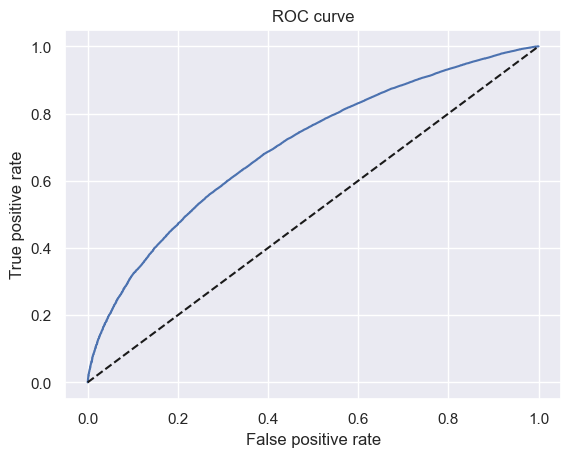

In [93]:
plt.plot(fpr, tpr)
plt.plot(fpr, fpr, linestyle = '--', color = 'k')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')

In [94]:
AUROC = roc_auc_score(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])
AUROC

0.7000983514599975

### Gini and Kolmogorov-Smirnov

In [95]:
df_actual_predicted_probs = df_actual_predicted_probs.sort_values('y_hat_test_proba')

In [96]:
df_actual_predicted_probs.head()

,loan_data_targets_test,y_hat_test_proba,y_hat_test
42341,1,0.391421,0
39810,0,0.404255,0
42344,1,0.423933,0
40518,0,0.439809,0
42368,0,0.457933,0


In [97]:
df_actual_predicted_probs.tail()

,loan_data_targets_test,y_hat_test_proba,y_hat_test
232642,1,0.991372,1
247902,1,0.991425,1
239228,1,0.991610,1
280481,1,0.991688,1
303408,1,0.992317,1


In [98]:
df_actual_predicted_probs = df_actual_predicted_probs.reset_index()

In [99]:
df_actual_predicted_probs.head()

,index,loan_data_targets_test,y_hat_test_proba,y_hat_test
0,42341,1,0.391421,0
1,39810,0,0.404255,0
2,42344,1,0.423933,0
3,40518,0,0.439809,0
4,42368,0,0.457933,0


In [100]:
df_actual_predicted_probs['Cumulative N Population'] = df_actual_predicted_probs.index + 1
df_actual_predicted_probs['Cumulative N Good'] = df_actual_predicted_probs['loan_data_targets_test'].cumsum()
df_actual_predicted_probs['Cumulative N Bad'] = df_actual_predicted_probs['Cumulative N Population'] - df_actual_predicted_probs['loan_data_targets_test'].cumsum()

In [101]:
df_actual_predicted_probs.head()

,index,loan_data_targets_test,y_hat_test_proba,y_hat_test,Cumulative N Population,Cumulative N Good,Cumulative N Bad
0,42341,1,0.391421,0,1,1,0
1,39810,0,0.404255,0,2,1,1
2,42344,1,0.423933,0,3,2,1
3,40518,0,0.439809,0,4,2,2
4,42368,0,0.457933,0,5,2,3


In [102]:
df_actual_predicted_probs['Cumulative Perc Population'] = df_actual_predicted_probs['Cumulative N Population'] / (df_actual_predicted_probs.shape[0])
df_actual_predicted_probs['Cumulative Perc Good'] = df_actual_predicted_probs['Cumulative N Good'] / df_actual_predicted_probs['loan_data_targets_test'].sum()
df_actual_predicted_probs['Cumulative Perc Bad'] = df_actual_predicted_probs['Cumulative N Bad'] / (df_actual_predicted_probs.shape[0] - df_actual_predicted_probs['loan_data_targets_test'].sum())

In [103]:
df_actual_predicted_probs.head()

,index,loan_data_targets_test,y_hat_test_proba,y_hat_test,Cumulative N Population,Cumulative N Good,Cumulative N Bad,Cumulative Perc Population,Cumulative Perc Good,Cumulative Perc Bad
0,42341,1,0.391421,0,1,1,0,0.000007,0.000008,0.000000
1,39810,0,0.404255,0,2,1,1,0.000014,0.000008,0.000065
2,42344,1,0.423933,0,3,2,1,0.000021,0.000016,0.000065
3,40518,0,0.439809,0,4,2,2,0.000029,0.000016,0.000130
4,42368,0,0.457933,0,5,2,3,0.000036,0.000016,0.000195


In [104]:
df_actual_predicted_probs.tail()

,index,loan_data_targets_test,y_hat_test_proba,y_hat_test,Cumulative N Population,Cumulative N Good,Cumulative N Bad,Cumulative Perc Population,Cumulative Perc Good,Cumulative Perc Bad
139881,232642,1,0.991372,1,139882,124500,15382,0.999971,0.999968,1.0
139882,247902,1,0.991425,1,139883,124501,15382,0.999979,0.999976,1.0
139883,239228,1,0.991610,1,139884,124502,15382,0.999986,0.999984,1.0
139884,280481,1,0.991688,1,139885,124503,15382,0.999993,0.999992,1.0
139885,303408,1,0.992317,1,139886,124504,15382,1.000000,1.000000,1.0


Text(0.5, 1.0, 'Gini')

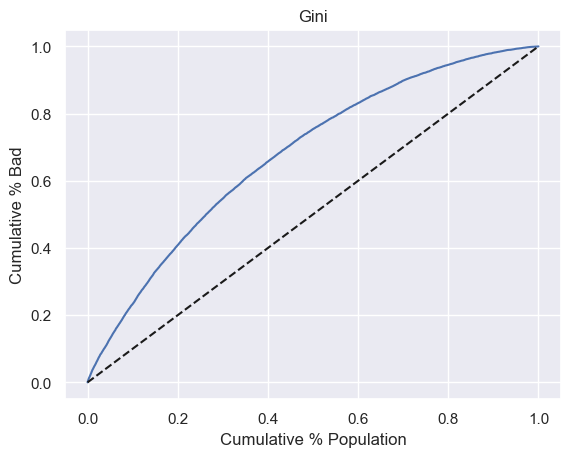

In [105]:
plt.plot(df_actual_predicted_probs['Cumulative Perc Population'], df_actual_predicted_probs['Cumulative Perc Bad'])
plt.plot(df_actual_predicted_probs['Cumulative Perc Population'], df_actual_predicted_probs['Cumulative Perc Population'], linestyle = '--', color = 'k')
plt.xlabel('Cumulative % Population')
plt.ylabel('Cumulative % Bad')
plt.title('Gini')

In [106]:
Gini = AUROC * 2 - 1
Gini

0.4001967029199951

Text(0.5, 1.0, 'Kolmogorov-Smirnov')

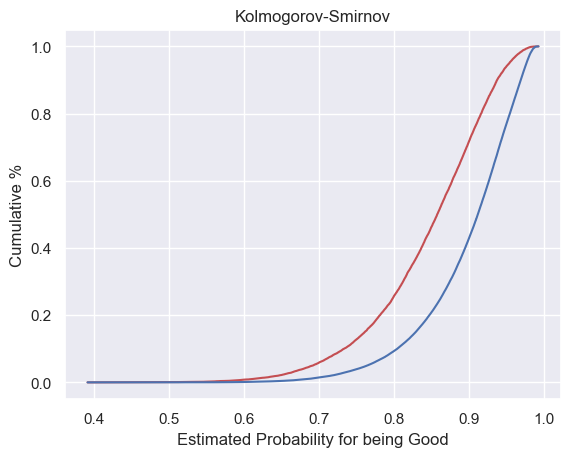

In [107]:
plt.plot(df_actual_predicted_probs['y_hat_test_proba'], df_actual_predicted_probs['Cumulative Perc Bad'], color = 'r')
plt.plot(df_actual_predicted_probs['y_hat_test_proba'], df_actual_predicted_probs['Cumulative Perc Good'], color = 'b')
plt.xlabel('Estimated Probability for being Good')
plt.ylabel('Cumulative %')
plt.title('Kolmogorov-Smirnov')

In [108]:
KS = max(df_actual_predicted_probs['Cumulative Perc Bad'] - df_actual_predicted_probs['Cumulative Perc Good'])
KS

0.2901817049501127

# Applying the PD Model

### Calculating PD of individual accounts

In [109]:
pd.options.display.max_columns = None

In [110]:
inputs_test_with_ref_cat.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,home_ownership:RENT_OTHER_NONE_ANY,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:ND_NE_IA_NV_FL_HI_AL,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:f,initial_list_status:w,term:36,term:60,emp_length:0,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,mths_since_issue_d:>84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,int_rate:>20.281,mths_since_earliest_cr_line:<140,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,inq_last_6mths:>6,acc_now_delinq:0,acc_now_delinq:>=1,annual_inc:<20K,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,dti:>35,mths_since_last_delinq:Missing,mths_since_last_delinq:0-3,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:0-2,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86
362514,False,False,True,False,False,False,False,0,False,True,0,0,False,0,True,0,0,0,0,0,False,0,0,0,False,False,True,0,False,False,0,1,True,False,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
288564,False,False,False,False,True,False,False,0,False,True,0,0,False,0,False,0,0,1,0,0,False,0,0,0,False,False,True,0,True,False,0,0,False,True,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0
213591,False,False,True,False,False,False,False,0,False,True,0,0,False,0,False,1,0,0,0,0,False,0,0,0,False,False,True,0,False,True,0,0,True,False,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
263083,False,False,True,False,False,False,False,0,False,True,0,0,False,0,False,0,1,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,False,True,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
165001,True,False,False,False,False,False,False,0,False,True,0,0,False,0,False,0,1,0,0,0,False,0,0,0,False,False,True,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0


In [111]:
summary_table

,Feature name,Coefficients,p_values
0,Intercept,-1.342911,NaN
1,grade:A,1.140065,6.340607e-32
2,grade:B,0.902121,1.383185e-43
3,grade:C,0.704802,1.526565e-31
4,grade:D,0.527135,2.741377e-20
5,grade:E,0.348454,5.741504e-12
6,grade:F,0.158731,2.523174e-03
7,home_ownership:OWN,0.101656,2.396765e-06
8,home_ownership:MORTGAGE,0.111739,1.537857e-16
9,addr_state:NM_VA,0.025409,4.580449e-01


In [112]:
y_hat_test_proba

array([0.91364624, 0.85474971, 0.88842744, ..., 0.95079051, 0.87137062,
       0.88711754])

### Creating a Scorecard

In [113]:
summary_table

,Feature name,Coefficients,p_values
0,Intercept,-1.342911,NaN
1,grade:A,1.140065,6.340607e-32
2,grade:B,0.902121,1.383185e-43
3,grade:C,0.704802,1.526565e-31
4,grade:D,0.527135,2.741377e-20
5,grade:E,0.348454,5.741504e-12
6,grade:F,0.158731,2.523174e-03
7,home_ownership:OWN,0.101656,2.396765e-06
8,home_ownership:MORTGAGE,0.111739,1.537857e-16
9,addr_state:NM_VA,0.025409,4.580449e-01


In [114]:
ref_categories

['grade:G',
 'home_ownership:RENT_OTHER_NONE_ANY',
 'addr_state:ND_NE_IA_NV_FL_HI_AL',
 'verification_status:Verified',
 'purpose:educ__sm_b__wedd__ren_en__mov__house',
 'initial_list_status:f',
 'term:60',
 'emp_length:0',
 'mths_since_issue_d:>84',
 'int_rate:>20.281',
 'mths_since_earliest_cr_line:<140',
 'inq_last_6mths:>6',
 'acc_now_delinq:0',
 'annual_inc:<20K',
 'dti:>35',
 'mths_since_last_delinq:0-3',
 'mths_since_last_record:0-2']

In [115]:
df_ref_categories = pd.DataFrame(ref_categories, columns = ['Feature name'])
df_ref_categories['Coefficients'] = 0
df_ref_categories['p_values'] = np.nan
df_ref_categories

,Feature name,Coefficients,p_values
0,grade:G,0,NaN
1,home_ownership:RENT_OTHER_NONE_ANY,0,NaN
2,addr_state:ND_NE_IA_NV_FL_HI_AL,0,NaN
3,verification_status:Verified,0,NaN
4,purpose:educ__sm_b__wedd__ren_en__mov__house,0,NaN
5,initial_list_status:f,0,NaN
6,term:60,0,NaN
7,emp_length:0,0,NaN
8,mths_since_issue_d:>84,0,NaN
9,int_rate:>20.281,0,NaN


In [116]:
df_scorecard = pd.concat([summary_table, df_ref_categories])
df_scorecard = df_scorecard.reset_index()
df_scorecard

,index,Feature name,Coefficients,p_values
0,0,Intercept,-1.342911,NaN
1,1,grade:A,1.140065,6.340607e-32
2,2,grade:B,0.902121,1.383185e-43
3,3,grade:C,0.704802,1.526565e-31
4,4,grade:D,0.527135,2.741377e-20
5,5,grade:E,0.348454,5.741504e-12
6,6,grade:F,0.158731,2.523174e-03
7,7,home_ownership:OWN,0.101656,2.396765e-06
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16
9,9,addr_state:NM_VA,0.025409,4.580449e-01


In [117]:
df_scorecard['Original feature name'] = df_scorecard['Feature name'].str.split(':').str[0]

In [118]:
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name
0,0,Intercept,-1.342911,NaN,Intercept
1,1,grade:A,1.140065,6.340607e-32,grade
2,2,grade:B,0.902121,1.383185e-43,grade
3,3,grade:C,0.704802,1.526565e-31,grade
4,4,grade:D,0.527135,2.741377e-20,grade
5,5,grade:E,0.348454,5.741504e-12,grade
6,6,grade:F,0.158731,2.523174e-03,grade
7,7,home_ownership:OWN,0.101656,2.396765e-06,home_ownership
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16,home_ownership
9,9,addr_state:NM_VA,0.025409,4.580449e-01,addr_state


In [119]:
min_score = 300
max_score = 900

In [120]:
df_scorecard.groupby('Original feature name')['Coefficients'].min()

Original feature name
Intercept                     -1.342911
acc_now_delinq                 0.000000
addr_state                     0.000000
annual_inc                    -0.075186
dti                            0.000000
emp_length                     0.000000
grade                          0.000000
home_ownership                 0.000000
initial_list_status            0.000000
inq_last_6mths                 0.000000
int_rate                       0.000000
mths_since_earliest_cr_line    0.000000
mths_since_issue_d            -0.084313
mths_since_last_delinq         0.000000
mths_since_last_record         0.000000
purpose                        0.000000
term                           0.000000
verification_status           -0.014303
Name: Coefficients, dtype: float64

In [121]:
min_sum_coef = df_scorecard.groupby('Original feature name')['Coefficients'].min().sum()
min_sum_coef

-1.5167132085152994

In [122]:
df_scorecard.groupby('Original feature name')['Coefficients'].max()

Original feature name
Intercept                     -1.342911
acc_now_delinq                 0.234028
addr_state                     0.526847
annual_inc                     0.567434
dti                            0.356232
emp_length                     0.137520
grade                          1.140065
home_ownership                 0.111739
initial_list_status            0.047664
inq_last_6mths                 0.708240
int_rate                       0.889035
mths_since_earliest_cr_line    0.121804
mths_since_issue_d             1.097423
mths_since_last_delinq         0.223852
mths_since_last_record         0.353982
purpose                        0.302737
term                           0.081734
verification_status            0.089607
Name: Coefficients, dtype: float64

In [123]:
max_sum_coef = df_scorecard.groupby('Original feature name')['Coefficients'].max().sum()
max_sum_coef

5.647033775109394

In [124]:
df_scorecard['Score - Calculation'] = df_scorecard['Coefficients'] * (max_score - min_score) / (max_sum_coef - min_sum_coef)
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation
0,0,Intercept,-1.342911,NaN,Intercept,-112.475600
1,1,grade:A,1.140065,6.340607e-32,grade,95.486228
2,2,grade:B,0.902121,1.383185e-43,grade,75.557193
3,3,grade:C,0.704802,1.526565e-31,grade,59.030700
4,4,grade:D,0.527135,2.741377e-20,grade,44.150201
5,5,grade:E,0.348454,5.741504e-12,grade,29.184742
6,6,grade:F,0.158731,2.523174e-03,grade,13.294513
7,7,home_ownership:OWN,0.101656,2.396765e-06,home_ownership,8.514203
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16,home_ownership,9.358703
9,9,addr_state:NM_VA,0.025409,4.580449e-01,addr_state,2.128152


In [125]:
df_scorecard['Score - Calculation'][0] = ((df_scorecard['Coefficients'][0] - min_sum_coef) / (max_sum_coef - min_sum_coef)) * (max_score - min_score) + min_score
df_scorecard

C:\Users\gabri\AppData\Local\Temp\ipykernel_12220\1263832758.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scorecard['Score - Calculation'][0] = ((df_scorecard['Coefficients'][0] - min_sum_coef) / (max_sum_coef - min_sum_coef)) * (max_score - min_score) + min_score


,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation
0,0,Intercept,-1.342911,NaN,Intercept,314.556793
1,1,grade:A,1.140065,6.340607e-32,grade,95.486228
2,2,grade:B,0.902121,1.383185e-43,grade,75.557193
3,3,grade:C,0.704802,1.526565e-31,grade,59.030700
4,4,grade:D,0.527135,2.741377e-20,grade,44.150201
5,5,grade:E,0.348454,5.741504e-12,grade,29.184742
6,6,grade:F,0.158731,2.523174e-03,grade,13.294513
7,7,home_ownership:OWN,0.101656,2.396765e-06,home_ownership,8.514203
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16,home_ownership,9.358703
9,9,addr_state:NM_VA,0.025409,4.580449e-01,addr_state,2.128152


In [126]:
df_scorecard['Score - Preliminary'] = df_scorecard['Score - Calculation'].round()
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary
0,0,Intercept,-1.342911,NaN,Intercept,314.556793,315.0
1,1,grade:A,1.140065,6.340607e-32,grade,95.486228,95.0
2,2,grade:B,0.902121,1.383185e-43,grade,75.557193,76.0
3,3,grade:C,0.704802,1.526565e-31,grade,59.030700,59.0
4,4,grade:D,0.527135,2.741377e-20,grade,44.150201,44.0
5,5,grade:E,0.348454,5.741504e-12,grade,29.184742,29.0
6,6,grade:F,0.158731,2.523174e-03,grade,13.294513,13.0
7,7,home_ownership:OWN,0.101656,2.396765e-06,home_ownership,8.514203,9.0
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16,home_ownership,9.358703,9.0
9,9,addr_state:NM_VA,0.025409,4.580449e-01,addr_state,2.128152,2.0


In [127]:
min_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Preliminary'].min().sum()
min_sum_score_prel

301.0

In [128]:
max_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Preliminary'].max().sum()
max_sum_score_prel

901.0

In [129]:
df_scorecard['Difference'] = df_scorecard['Score - Preliminary'] - df_scorecard['Score - Calculation']
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference
0,0,Intercept,-1.342911,NaN,Intercept,314.556793,315.0,0.443207
1,1,grade:A,1.140065,6.340607e-32,grade,95.486228,95.0,-0.486228
2,2,grade:B,0.902121,1.383185e-43,grade,75.557193,76.0,0.442807
3,3,grade:C,0.704802,1.526565e-31,grade,59.030700,59.0,-0.030700
4,4,grade:D,0.527135,2.741377e-20,grade,44.150201,44.0,-0.150201
5,5,grade:E,0.348454,5.741504e-12,grade,29.184742,29.0,-0.184742
6,6,grade:F,0.158731,2.523174e-03,grade,13.294513,13.0,-0.294513
7,7,home_ownership:OWN,0.101656,2.396765e-06,home_ownership,8.514203,9.0,0.485797
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16,home_ownership,9.358703,9.0,-0.358703
9,9,addr_state:NM_VA,0.025409,4.580449e-01,addr_state,2.128152,2.0,-0.128152


In [130]:
df_scorecard['Score - Final'] = df_scorecard['Score - Preliminary']
df_scorecard['Score - Final'][77] = 16
df_scorecard

C:\Users\gabri\AppData\Local\Temp\ipykernel_12220\1528914224.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_scorecard['Score - Final'][77] = 16


,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference,Score - Final
0,0,Intercept,-1.342911,NaN,Intercept,314.556793,315.0,0.443207,315.0
1,1,grade:A,1.140065,6.340607e-32,grade,95.486228,95.0,-0.486228,95.0
2,2,grade:B,0.902121,1.383185e-43,grade,75.557193,76.0,0.442807,76.0
3,3,grade:C,0.704802,1.526565e-31,grade,59.030700,59.0,-0.030700,59.0
4,4,grade:D,0.527135,2.741377e-20,grade,44.150201,44.0,-0.150201,44.0
5,5,grade:E,0.348454,5.741504e-12,grade,29.184742,29.0,-0.184742,29.0
6,6,grade:F,0.158731,2.523174e-03,grade,13.294513,13.0,-0.294513,13.0
7,7,home_ownership:OWN,0.101656,2.396765e-06,home_ownership,8.514203,9.0,0.485797,9.0
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16,home_ownership,9.358703,9.0,-0.358703,9.0
9,9,addr_state:NM_VA,0.025409,4.580449e-01,addr_state,2.128152,2.0,-0.128152,2.0


In [131]:
min_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Final'].min().sum()
min_sum_score_prel

301.0

In [132]:
max_sum_score_prel = df_scorecard.groupby('Original feature name')['Score - Final'].max().sum()
max_sum_score_prel

898.0

### Caclulating Credit Score

In [133]:
inputs_test_with_ref_cat.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,home_ownership:RENT_OTHER_NONE_ANY,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:ND_NE_IA_NV_FL_HI_AL,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:f,initial_list_status:w,term:36,term:60,emp_length:0,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,mths_since_issue_d:>84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,int_rate:>20.281,mths_since_earliest_cr_line:<140,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,inq_last_6mths:>6,acc_now_delinq:0,acc_now_delinq:>=1,annual_inc:<20K,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,dti:>35,mths_since_last_delinq:Missing,mths_since_last_delinq:0-3,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:0-2,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86
362514,False,False,True,False,False,False,False,0,False,True,0,0,False,0,True,0,0,0,0,0,False,0,0,0,False,False,True,0,False,False,0,1,True,False,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
288564,False,False,False,False,True,False,False,0,False,True,0,0,False,0,False,0,0,1,0,0,False,0,0,0,False,False,True,0,True,False,0,0,False,True,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0
213591,False,False,True,False,False,False,False,0,False,True,0,0,False,0,False,1,0,0,0,0,False,0,0,0,False,False,True,0,False,True,0,0,True,False,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
263083,False,False,True,False,False,False,False,0,False,True,0,0,False,0,False,0,1,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,False,True,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
165001,True,False,False,False,False,False,False,0,False,True,0,0,False,0,False,0,1,0,0,0,False,0,0,0,False,False,True,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0


In [134]:
df_scorecard

,index,Feature name,Coefficients,p_values,Original feature name,Score - Calculation,Score - Preliminary,Difference,Score - Final
0,0,Intercept,-1.342911,NaN,Intercept,314.556793,315.0,0.443207,315.0
1,1,grade:A,1.140065,6.340607e-32,grade,95.486228,95.0,-0.486228,95.0
2,2,grade:B,0.902121,1.383185e-43,grade,75.557193,76.0,0.442807,76.0
3,3,grade:C,0.704802,1.526565e-31,grade,59.030700,59.0,-0.030700,59.0
4,4,grade:D,0.527135,2.741377e-20,grade,44.150201,44.0,-0.150201,44.0
5,5,grade:E,0.348454,5.741504e-12,grade,29.184742,29.0,-0.184742,29.0
6,6,grade:F,0.158731,2.523174e-03,grade,13.294513,13.0,-0.294513,13.0
7,7,home_ownership:OWN,0.101656,2.396765e-06,home_ownership,8.514203,9.0,0.485797,9.0
8,8,home_ownership:MORTGAGE,0.111739,1.537857e-16,home_ownership,9.358703,9.0,-0.358703,9.0
9,9,addr_state:NM_VA,0.025409,4.580449e-01,addr_state,2.128152,2.0,-0.128152,2.0


In [135]:
inputs_test_with_ref_cat_w_intercept = inputs_test_with_ref_cat

In [136]:
inputs_test_with_ref_cat_w_intercept.insert(0, 'Intercept', 1)

In [137]:
inputs_test_with_ref_cat_w_intercept.head()

,Intercept,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,home_ownership:RENT_OTHER_NONE_ANY,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:ND_NE_IA_NV_FL_HI_AL,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:f,initial_list_status:w,term:36,term:60,emp_length:0,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,mths_since_issue_d:>84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,int_rate:>20.281,mths_since_earliest_cr_line:<140,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,inq_last_6mths:>6,acc_now_delinq:0,acc_now_delinq:>=1,annual_inc:<20K,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,dti:>35,mths_since_last_delinq:Missing,mths_since_last_delinq:0-3,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:0-2,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86
362514,1,False,False,True,False,False,False,False,0,False,True,0,0,False,0,True,0,0,0,0,0,False,0,0,0,False,False,True,0,False,False,0,1,True,False,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
288564,1,False,False,False,False,True,False,False,0,False,True,0,0,False,0,False,0,0,1,0,0,False,0,0,0,False,False,True,0,True,False,0,0,False,True,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0
213591,1,False,False,True,False,False,False,False,0,False,True,0,0,False,0,False,1,0,0,0,0,False,0,0,0,False,False,True,0,False,True,0,0,True,False,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0
263083,1,False,False,True,False,False,False,False,0,False,True,0,0,False,0,False,0,1,0,0,0,False,0,0,0,False,True,False,0,False,True,0,0,False,True,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0
165001,1,True,False,False,False,False,False,False,0,False,True,0,0,False,0,False,0,1,0,0,0,False,0,0,0,False,False,True,0,False,True,0,0,True,False,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0


In [138]:
inputs_test_with_ref_cat_w_intercept = inputs_test_with_ref_cat_w_intercept[df_scorecard['Feature name'].values]

In [139]:
inputs_test_with_ref_cat_w_intercept.head()

,Intercept,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,home_ownership:OWN,home_ownership:MORTGAGE,addr_state:NM_VA,addr_state:NY,addr_state:OK_TN_MO_LA_MD_NC,addr_state:CA,addr_state:UT_KY_AZ_NJ,addr_state:AR_MI_PA_OH_MN,addr_state:RI_MA_DE_SD_IN,addr_state:GA_WA_OR,addr_state:WI_MT,addr_state:TX,addr_state:IL_CT,addr_state:KS_SC_CO_VT_AK_MS,addr_state:WV_NH_WY_DC_ME_ID,verification_status:Not Verified,verification_status:Source Verified,purpose:credit_card,purpose:debt_consolidation,purpose:oth__med__vacation,purpose:major_purch__car__home_impr,initial_list_status:w,term:36,emp_length:1,emp_length:2-4,emp_length:5-6,emp_length:7-9,emp_length:10,mths_since_issue_d:<38,mths_since_issue_d:38-39,mths_since_issue_d:40-41,mths_since_issue_d:42-48,mths_since_issue_d:49-52,mths_since_issue_d:53-64,mths_since_issue_d:65-84,int_rate:<9.548,int_rate:9.548-12.025,int_rate:12.025-15.74,int_rate:15.74-20.281,mths_since_earliest_cr_line:141-164,mths_since_earliest_cr_line:165-247,mths_since_earliest_cr_line:248-270,mths_since_earliest_cr_line:271-352,mths_since_earliest_cr_line:>352,inq_last_6mths:0,inq_last_6mths:1-2,inq_last_6mths:3-6,acc_now_delinq:>=1,annual_inc:20K-30K,annual_inc:30K-40K,annual_inc:40K-50K,annual_inc:50K-60K,annual_inc:60K-70K,annual_inc:70K-80K,annual_inc:80K-90K,annual_inc:90K-100K,annual_inc:100K-120K,annual_inc:120K-140K,annual_inc:>140K,dti:<=1.4,dti:1.4-3.5,dti:3.5-7.7,dti:7.7-10.5,dti:10.5-16.1,dti:16.1-20.3,dti:20.3-21.7,dti:21.7-22.4,dti:22.4-35,mths_since_last_delinq:Missing,mths_since_last_delinq:4-30,mths_since_last_delinq:31-56,mths_since_last_delinq:>=57,mths_since_last_record:Missing,mths_since_last_record:3-20,mths_since_last_record:21-31,mths_since_last_record:32-80,mths_since_last_record:81-86,mths_since_last_record:>=86,grade:G,home_ownership:RENT_OTHER_NONE_ANY,addr_state:ND_NE_IA_NV_FL_HI_AL,verification_status:Verified,purpose:educ__sm_b__wedd__ren_en__mov__house,initial_list_status:f,term:60,emp_length:0,mths_since_issue_d:>84,int_rate:>20.281,mths_since_earliest_cr_line:<140,inq_last_6mths:>6,acc_now_delinq:0,annual_inc:<20K,dti:>35,mths_since_last_delinq:0-3,mths_since_last_record:0-2
362514,1,False,False,True,False,False,False,False,True,0,False,0,True,0,0,0,0,0,False,0,0,0,False,False,False,False,0,1,False,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,False,0,0,True,0,True,1,1,0,0,0,0,1,0,0,0,0
288564,1,False,False,False,False,True,False,False,True,0,False,0,False,0,0,1,0,0,False,0,0,0,False,False,True,False,0,0,True,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,False,0,0,True,0,False,1,0,0,1,0,0,1,0,0,1,0
213591,1,False,False,True,False,False,False,False,True,0,False,0,False,1,0,0,0,0,False,0,0,0,False,False,False,True,0,0,False,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,False,0,0,True,0,True,0,0,0,0,0,0,1,0,0,0,0
263083,1,False,False,True,False,False,False,False,True,0,False,0,False,0,1,0,0,0,False,0,0,0,False,True,False,True,0,0,True,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,False,0,0,False,0,False,1,0,0,0,1,0,1,0,0,0,0
165001,1,True,False,False,False,False,False,False,True,0,False,0,False,0,1,0,0,0,False,0,0,0,False,False,False,True,0,0,False,1,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,False,0,0,True,0,True,0,0,0,0,0,0,1,0,0,0,0


In [140]:
scorecard_scores = df_scorecard['Score - Final']

In [141]:
inputs_test_with_ref_cat_w_intercept.shape

(139886, 102)

In [142]:
scorecard_scores.shape

(102,)

In [143]:
scorecard_scores = scorecard_scores.values.reshape(102, 1)

In [144]:
scorecard_scores.shape

(102, 1)

In [145]:
y_scores = inputs_test_with_ref_cat_w_intercept.dot(scorecard_scores)

In [146]:
y_scores.head()

,0
362514,624.0
288564,575.0
213591,598.0
263083,650.0
165001,713.0


In [147]:
y_scores.tail()

,0
403809,619.0
2981,601.0
297156,676.0
388967,587.0
147948,601.0


### From Credit Score to PD

In [148]:
sum_coef_from_score = ((y_scores - min_score) / (max_score - min_score)) * (max_sum_coef - min_sum_coef) + min_sum_coef
sum_coef_from_score

,0
362514,2.35171
288564,1.766671
213591,2.041281
263083,2.662139
165001,3.414333
82511,1.504
24671,1.695033
97373,1.014477
44058,3.008387
351326,3.127783


In [150]:
print(type(sum_coef_from_score))

<class 'pandas.core.frame.DataFrame'>


In [151]:
sum_coef_from_score = np.array(sum_coef_from_score, dtype=np.float64)

In [153]:
y_hat_proba_from_score = np.exp(sum_coef_from_score) / (np.exp(sum_coef_from_score) + 1)


In [154]:
print(y_hat_proba_from_score[:5])

[[0.91307006]
 [0.85404317]
 [0.88506366]
 [0.93475525]
 [0.96814948]]


In [155]:
y_hat_test_proba[0: 5]

array([0.91364624, 0.85474971, 0.88842744, 0.93487842, 0.96959017])

In [156]:
df_actual_predicted_probs['y_hat_test_proba'].head()

0    0.391421
1    0.404255
2    0.423933
3    0.439809
4    0.457933
Name: y_hat_test_proba, dtype: float64

### Setting Cut-offs

In [157]:
tr = 0.9
df_actual_predicted_probs['y_hat_test'] = np.where(df_actual_predicted_probs['y_hat_test_proba'] > tr, 1, 0)

In [158]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted'])

Predicted,0,1
Actual,,
0,11054,4328
1,53506,70998


In [159]:
pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]

Predicted,0,1
Actual,,
0,0.079021,0.030939
1,0.382497,0.507542


In [160]:
(pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[0, 0] + (pd.crosstab(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test'],
           rownames = ['Actual'], colnames = ['Predicted']) / df_actual_predicted_probs.shape[0]).iloc[1, 1]

0.5865633444376135

In [161]:
from sklearn.metrics import roc_curve, roc_auc_score

In [162]:
roc_curve(df_actual_predicted_probs['loan_data_targets_test'], df_actual_predicted_probs['y_hat_test_proba'])

(array([0.        , 0.        , 0.        , ..., 0.99993499, 1.        ,
        1.        ]),
 array([0.00000000e+00, 8.03187046e-06, 8.83505751e-05, ...,
        9.99991968e-01, 9.99991968e-01, 1.00000000e+00]),
 array([1.99231675, 0.99231675, 0.99087991, ..., 0.42393287, 0.40425528,
        0.39142087]))

In [163]:
fpr, tpr, thresholds = roc_curve(df_actual_predicted_probs['loan_data_targets_test'],
                                 df_actual_predicted_probs['y_hat_test_proba'])

In [164]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Text(0.5, 1.0, 'ROC curve')

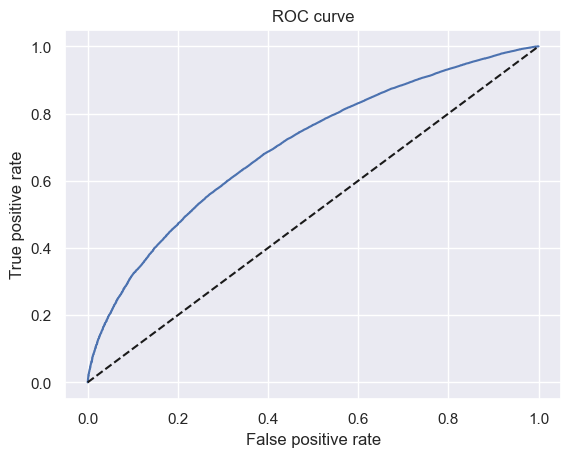

In [165]:
plt.plot(fpr, tpr)
plt.plot(fpr, fpr, linestyle = '--', color = 'k')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')

In [166]:
thresholds

array([1.99231675, 0.99231675, 0.99087991, ..., 0.42393287, 0.40425528,
       0.39142087])

In [167]:
thresholds.shape

(26343,)

In [168]:
df_cutoffs = pd.concat([pd.DataFrame(thresholds), pd.DataFrame(fpr), pd.DataFrame(tpr)], axis = 1)

In [169]:
df_cutoffs.columns = ['thresholds', 'fpr', 'tpr']

In [170]:
df_cutoffs.head()

,thresholds,fpr,tpr
0,1.992317,0.000000,0.000000
1,0.992317,0.000000,0.000008
2,0.990880,0.000000,0.000088
3,0.990856,0.000065,0.000088
4,0.989520,0.000065,0.000442


In [171]:
df_cutoffs['thresholds'][0] = 1 - 1 / np.power(10, 16)

In [173]:
df_cutoffs['Score'] = ((np.log(df_cutoffs['thresholds'] / (1 - df_cutoffs['thresholds'])) - min_sum_coef) * ((max_score - min_score) / (max_sum_coef - min_sum_coef)) + min_score).round()


In [174]:
df_cutoffs.head()

,thresholds,fpr,tpr,Score
0,1.000000,0.000000,0.000000,2215.0
1,0.992317,0.000000,0.000008,834.0
2,0.990880,0.000000,0.000088,820.0
3,0.990856,0.000065,0.000088,819.0
4,0.989520,0.000065,0.000442,808.0


In [175]:
df_cutoffs['Score'][0] = max_score

In [176]:
df_cutoffs.head()

,thresholds,fpr,tpr,Score
0,1.000000,0.000000,0.000000,900.0
1,0.992317,0.000000,0.000008,834.0
2,0.990880,0.000000,0.000088,820.0
3,0.990856,0.000065,0.000088,819.0
4,0.989520,0.000065,0.000442,808.0


In [177]:
df_cutoffs.tail()

,thresholds,fpr,tpr,Score
26338,0.476939,0.999675,0.999984,419.0
26339,0.439809,0.999935,0.999984,407.0
26340,0.423933,0.999935,0.999992,401.0
26341,0.404255,1.000000,0.999992,395.0
26342,0.391421,1.000000,1.000000,390.0


In [178]:
def n_approved(p):
    return np.where(df_actual_predicted_probs['y_hat_test_proba'] >= p, 1, 0).sum()

In [179]:
df_cutoffs['N Approved'] = df_cutoffs['thresholds'].apply(n_approved)
df_cutoffs['N Rejected'] = df_actual_predicted_probs['y_hat_test_proba'].shape[0] - df_cutoffs['N Approved']
df_cutoffs['Approval Rate'] = df_cutoffs['N Approved'] / df_actual_predicted_probs['y_hat_test_proba'].shape[0]
df_cutoffs['Rejection Rate'] = 1 - df_cutoffs['Approval Rate']

In [180]:
df_cutoffs.head()

,thresholds,fpr,tpr,Score,N Approved,N Rejected,Approval Rate,Rejection Rate
0,1.000000,0.000000,0.000000,900.0,0,139886,0.000000,1.000000
1,0.992317,0.000000,0.000008,834.0,1,139885,0.000007,0.999993
2,0.990880,0.000000,0.000088,820.0,11,139875,0.000079,0.999921
3,0.990856,0.000065,0.000088,819.0,12,139874,0.000086,0.999914
4,0.989520,0.000065,0.000442,808.0,56,139830,0.000400,0.999600


In [181]:
df_cutoffs.tail()

,thresholds,fpr,tpr,Score,N Approved,N Rejected,Approval Rate,Rejection Rate
26338,0.476939,0.999675,0.999984,419.0,139879,7,0.999950,0.000050
26339,0.439809,0.999935,0.999984,407.0,139883,3,0.999979,0.000021
26340,0.423933,0.999935,0.999992,401.0,139884,2,0.999986,0.000014
26341,0.404255,1.000000,0.999992,395.0,139885,1,0.999993,0.000007
26342,0.391421,1.000000,1.000000,390.0,139886,0,1.000000,0.000000


In [182]:
df_cutoffs.iloc[5000: 6200, ]

,thresholds,fpr,tpr,Score,N Approved,N Rejected,Approval Rate,Rejection Rate
5000,0.922992,0.165648,0.423247,635.0,55244,84642,0.394922,0.605078
5001,0.922978,0.165648,0.423320,635.0,55253,84633,0.394986,0.605014
5002,0.922977,0.165713,0.423320,635.0,55254,84632,0.394993,0.605007
5003,0.922976,0.165713,0.423344,635.0,55257,84629,0.395015,0.604985
5004,0.922976,0.165778,0.423344,635.0,55258,84628,0.395022,0.604978
5005,0.922958,0.165778,0.423464,635.0,55273,84613,0.395129,0.604871
5006,0.922958,0.165843,0.423464,635.0,55274,84612,0.395136,0.604864
5007,0.922955,0.165843,0.423488,635.0,55277,84609,0.395157,0.604843
5008,0.922955,0.165908,0.423488,635.0,55278,84608,0.395165,0.604835
5009,0.922942,0.165908,0.423593,635.0,55291,84595,0.395258,0.604742


In [183]:
df_cutoffs.iloc[1000: 2000, ]

,thresholds,fpr,tpr,Score,N Approved,N Rejected,Approval Rate,Rejection Rate
1000,0.960949,0.031400,0.153104,695.0,19545,120341,0.139721,0.860279
1001,0.960949,0.031465,0.153104,695.0,19546,120340,0.139728,0.860272
1002,0.960896,0.031465,0.153425,695.0,19586,120300,0.140014,0.859986
1003,0.960895,0.031530,0.153425,695.0,19587,120299,0.140021,0.859979
1004,0.960894,0.031530,0.153433,695.0,19588,120298,0.140028,0.859972
1005,0.960894,0.031595,0.153433,695.0,19589,120297,0.140035,0.859965
1006,0.960892,0.031595,0.153457,695.0,19592,120294,0.140057,0.859943
1007,0.960891,0.031660,0.153457,695.0,19593,120293,0.140064,0.859936
1008,0.960851,0.031660,0.153746,695.0,19629,120257,0.140321,0.859679
1009,0.960849,0.031725,0.153746,695.0,19630,120256,0.140329,0.859671


In [184]:
inputs_train_with_ref_cat.to_csv('inputs_train_with_ref_cat.csv')

In [185]:
df_scorecard.to_csv('df_scorecard.csv')